In [1]:
import pandas as pd
import numpy as np
import missingno as mn

import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob

import glob
import os

import abc
import numpy as np

import pandas as pd
import abc
import re
import nltk
from sklearn import model_selection 
%matplotlib inline

In [2]:
from ekphrasis.classes.preprocessor import TextPreProcessor
from ekphrasis.classes.tokenizer import SocialTokenizer
from ekphrasis.dicts.emoticons import emoticons

In [3]:
text_processor = TextPreProcessor(
    # terms that will be normalized
    normalize=['url', 'email', 'percent', 'money', 'phone', 'user',
        'time', 'url', 'date', 'number'],
    # terms that will be annotated
    annotate={"hashtag", "allcaps", "elongated", "repeated",
        'emphasis', 'censored'},
    fix_html=True,  # fix HTML tokens
    
    # corpus from which the word statistics are going to be used 
    # for word segmentation 
    segmenter="twitter", 
    
    # corpus from which the word statistics are going to be used 
    # for spell correction
    corrector="twitter", 
    
    unpack_hashtags=True,  # perform word segmentation on hashtags
    unpack_contractions=True,  # Unpack contractions (can't -> can not)
    spell_correct_elong=False,  # spell correction for elongated words
    
    # select a tokenizer. You can use SocialTokenizer, or pass your own
    # the tokenizer, should take as input a string and return a list of tokens
    tokenizer=SocialTokenizer(lowercase=True).tokenize,
    
    # list of dictionaries, for replacing tokens extracted from the text,
    # with other expressions. You can pass more than one dictionaries.
    dicts=[emoticons]
)

Reading twitter - 1grams ...
Reading twitter - 2grams ...
Reading twitter - 1grams ...


In [4]:
def createComparableDataset(_df):
    _df.date = pd.to_datetime(_df.date)
    _df = _df[_df['date'] >= pd.to_datetime('2015/05/04')]
    _df = _df[_df['date'] <= pd.to_datetime('2019/03/28')]
    return _df

## Merge Tweet dataset

In [5]:
pathOfCwd = os.getcwd()
pathOfCwd
TweetsFolder = r'\\Tweets\\' # use your path
path = pathOfCwd +TweetsFolder
all_files = glob.glob(path + "/*.csv")

li = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header='infer', sep=';', error_bad_lines=False)
    li.append(df)

frame = pd.concat(li, axis=0, ignore_index=True)

b'Skipping line 155: expected 9 fields, saw 10\nSkipping line 167: expected 9 fields, saw 11\nSkipping line 170: expected 9 fields, saw 10\nSkipping line 177: expected 9 fields, saw 10\nSkipping line 180: expected 9 fields, saw 10\nSkipping line 200: expected 9 fields, saw 10\nSkipping line 279: expected 9 fields, saw 10\nSkipping line 287: expected 9 fields, saw 10\nSkipping line 306: expected 9 fields, saw 10\nSkipping line 317: expected 9 fields, saw 10\nSkipping line 344: expected 9 fields, saw 10\nSkipping line 346: expected 9 fields, saw 10\nSkipping line 350: expected 9 fields, saw 10\nSkipping line 351: expected 9 fields, saw 10\nSkipping line 358: expected 9 fields, saw 10\nSkipping line 377: expected 9 fields, saw 10\nSkipping line 381: expected 9 fields, saw 10\nSkipping line 397: expected 9 fields, saw 10\nSkipping line 400: expected 9 fields, saw 11\nSkipping line 401: expected 9 fields, saw 10\nSkipping line 408: expected 9 fields, saw 10\nSkipping line 409: expected 9 fi

b'Skipping line 76161: expected 9 fields, saw 10\nSkipping line 76187: expected 9 fields, saw 10\nSkipping line 76189: expected 9 fields, saw 10\nSkipping line 76191: expected 9 fields, saw 10\nSkipping line 76193: expected 9 fields, saw 10\nSkipping line 76234: expected 9 fields, saw 10\nSkipping line 76235: expected 9 fields, saw 10\nSkipping line 76238: expected 9 fields, saw 10\nSkipping line 76239: expected 9 fields, saw 10\nSkipping line 76268: expected 9 fields, saw 10\nSkipping line 76446: expected 9 fields, saw 10\nSkipping line 76505: expected 9 fields, saw 10\nSkipping line 76559: expected 9 fields, saw 10\nSkipping line 76560: expected 9 fields, saw 10\nSkipping line 76561: expected 9 fields, saw 10\nSkipping line 76562: expected 9 fields, saw 10\nSkipping line 76563: expected 9 fields, saw 10\nSkipping line 76569: expected 9 fields, saw 10\nSkipping line 76570: expected 9 fields, saw 10\nSkipping line 76573: expected 9 fields, saw 10\nSkipping line 76576: expected 9 fields

b'Skipping line 144866: expected 9 fields, saw 10\nSkipping line 144894: expected 9 fields, saw 10\nSkipping line 144950: expected 9 fields, saw 10\nSkipping line 144967: expected 9 fields, saw 11\nSkipping line 145004: expected 9 fields, saw 10\nSkipping line 145009: expected 9 fields, saw 10\nSkipping line 145012: expected 9 fields, saw 10\nSkipping line 145015: expected 9 fields, saw 10\nSkipping line 145035: expected 9 fields, saw 10\nSkipping line 145037: expected 9 fields, saw 10\nSkipping line 145048: expected 9 fields, saw 10\nSkipping line 145064: expected 9 fields, saw 10\nSkipping line 145071: expected 9 fields, saw 11\nSkipping line 145076: expected 9 fields, saw 10\nSkipping line 145087: expected 9 fields, saw 10\nSkipping line 145089: expected 9 fields, saw 10\nSkipping line 145091: expected 9 fields, saw 10\nSkipping line 145092: expected 9 fields, saw 10\nSkipping line 145095: expected 9 fields, saw 10\nSkipping line 145096: expected 9 fields, saw 10\nSkipping line 1451

b'Skipping line 221713: expected 9 fields, saw 10\nSkipping line 221723: expected 9 fields, saw 10\nSkipping line 221758: expected 9 fields, saw 10\nSkipping line 221763: expected 9 fields, saw 10\nSkipping line 221769: expected 9 fields, saw 10\nSkipping line 221785: expected 9 fields, saw 11\nSkipping line 221795: expected 9 fields, saw 10\nSkipping line 221802: expected 9 fields, saw 11\nSkipping line 221838: expected 9 fields, saw 10\nSkipping line 221849: expected 9 fields, saw 10\nSkipping line 221858: expected 9 fields, saw 11\nSkipping line 221868: expected 9 fields, saw 10\nSkipping line 221889: expected 9 fields, saw 10\nSkipping line 221906: expected 9 fields, saw 10\nSkipping line 221911: expected 9 fields, saw 10\nSkipping line 221925: expected 9 fields, saw 10\nSkipping line 221930: expected 9 fields, saw 10\nSkipping line 221946: expected 9 fields, saw 10\nSkipping line 221960: expected 9 fields, saw 10\nSkipping line 221978: expected 9 fields, saw 10\nSkipping line 2219

b'Skipping line 291839: expected 9 fields, saw 10\nSkipping line 291862: expected 9 fields, saw 10\nSkipping line 291938: expected 9 fields, saw 10\nSkipping line 292012: expected 9 fields, saw 10\nSkipping line 292092: expected 9 fields, saw 10\nSkipping line 292134: expected 9 fields, saw 10\nSkipping line 292156: expected 9 fields, saw 11\nSkipping line 292209: expected 9 fields, saw 10\nSkipping line 292327: expected 9 fields, saw 10\nSkipping line 292337: expected 9 fields, saw 10\nSkipping line 292358: expected 9 fields, saw 10\nSkipping line 292465: expected 9 fields, saw 12\nSkipping line 292627: expected 9 fields, saw 11\nSkipping line 292764: expected 9 fields, saw 10\nSkipping line 292798: expected 9 fields, saw 10\nSkipping line 292799: expected 9 fields, saw 10\nSkipping line 292800: expected 9 fields, saw 10\nSkipping line 292877: expected 9 fields, saw 10\nSkipping line 292898: expected 9 fields, saw 10\nSkipping line 293244: expected 9 fields, saw 11\nSkipping line 2932

b'Skipping line 358494: expected 9 fields, saw 10\nSkipping line 358495: expected 9 fields, saw 10\nSkipping line 358498: expected 9 fields, saw 10\nSkipping line 358499: expected 9 fields, saw 10\nSkipping line 358631: expected 9 fields, saw 10\nSkipping line 358897: expected 9 fields, saw 10\nSkipping line 359158: expected 9 fields, saw 10\nSkipping line 359231: expected 9 fields, saw 10\nSkipping line 359325: expected 9 fields, saw 10\nSkipping line 359592: expected 9 fields, saw 10\nSkipping line 359747: expected 9 fields, saw 10\nSkipping line 359748: expected 9 fields, saw 10\nSkipping line 359751: expected 9 fields, saw 10\nSkipping line 359858: expected 9 fields, saw 10\nSkipping line 360009: expected 9 fields, saw 10\nSkipping line 360093: expected 9 fields, saw 10\nSkipping line 360094: expected 9 fields, saw 10\nSkipping line 360182: expected 9 fields, saw 10\nSkipping line 360213: expected 9 fields, saw 10\nSkipping line 360241: expected 9 fields, saw 10\nSkipping line 3604

b'Skipping line 425073: expected 9 fields, saw 10\nSkipping line 425102: expected 9 fields, saw 10\nSkipping line 425137: expected 9 fields, saw 10\nSkipping line 425161: expected 9 fields, saw 10\nSkipping line 425178: expected 9 fields, saw 10\nSkipping line 425190: expected 9 fields, saw 10\nSkipping line 425249: expected 9 fields, saw 10\nSkipping line 425288: expected 9 fields, saw 10\nSkipping line 425312: expected 9 fields, saw 11\nSkipping line 425382: expected 9 fields, saw 10\nSkipping line 425522: expected 9 fields, saw 10\nSkipping line 425587: expected 9 fields, saw 10\nSkipping line 425852: expected 9 fields, saw 10\nSkipping line 425911: expected 9 fields, saw 10\nSkipping line 425973: expected 9 fields, saw 10\nSkipping line 426009: expected 9 fields, saw 10\nSkipping line 426110: expected 9 fields, saw 10\nSkipping line 426115: expected 9 fields, saw 10\nSkipping line 426117: expected 9 fields, saw 10\nSkipping line 426195: expected 9 fields, saw 10\nSkipping line 4262

b'Skipping line 491746: expected 9 fields, saw 10\nSkipping line 491747: expected 9 fields, saw 10\nSkipping line 491748: expected 9 fields, saw 10\nSkipping line 491821: expected 9 fields, saw 11\nSkipping line 491829: expected 9 fields, saw 10\nSkipping line 491839: expected 9 fields, saw 10\nSkipping line 491857: expected 9 fields, saw 10\nSkipping line 491858: expected 9 fields, saw 10\nSkipping line 491889: expected 9 fields, saw 10\nSkipping line 491907: expected 9 fields, saw 10\nSkipping line 491910: expected 9 fields, saw 10\nSkipping line 491916: expected 9 fields, saw 10\nSkipping line 491918: expected 9 fields, saw 10\nSkipping line 491919: expected 9 fields, saw 10\nSkipping line 491922: expected 9 fields, saw 10\nSkipping line 492264: expected 9 fields, saw 10\nSkipping line 492374: expected 9 fields, saw 10\nSkipping line 492381: expected 9 fields, saw 10\nSkipping line 492399: expected 9 fields, saw 10\nSkipping line 492481: expected 9 fields, saw 10\nSkipping line 4925

b'Skipping line 558431: expected 9 fields, saw 10\nSkipping line 558434: expected 9 fields, saw 10\nSkipping line 558450: expected 9 fields, saw 10\nSkipping line 558486: expected 9 fields, saw 10\nSkipping line 558629: expected 9 fields, saw 10\nSkipping line 558691: expected 9 fields, saw 10\nSkipping line 558697: expected 9 fields, saw 10\nSkipping line 558736: expected 9 fields, saw 10\nSkipping line 558789: expected 9 fields, saw 10\nSkipping line 558812: expected 9 fields, saw 10\nSkipping line 558813: expected 9 fields, saw 10\nSkipping line 558841: expected 9 fields, saw 10\nSkipping line 558881: expected 9 fields, saw 10\nSkipping line 559061: expected 9 fields, saw 10\nSkipping line 559199: expected 9 fields, saw 10\nSkipping line 559218: expected 9 fields, saw 10\nSkipping line 559226: expected 9 fields, saw 10\nSkipping line 559271: expected 9 fields, saw 10\nSkipping line 559278: expected 9 fields, saw 10\nSkipping line 559280: expected 9 fields, saw 10\nSkipping line 5592

b'Skipping line 625317: expected 9 fields, saw 10\nSkipping line 625330: expected 9 fields, saw 10\nSkipping line 625398: expected 9 fields, saw 10\nSkipping line 625436: expected 9 fields, saw 10\nSkipping line 625498: expected 9 fields, saw 10\nSkipping line 625601: expected 9 fields, saw 10\nSkipping line 625633: expected 9 fields, saw 10\nSkipping line 625673: expected 9 fields, saw 10\nSkipping line 625773: expected 9 fields, saw 10\nSkipping line 625775: expected 9 fields, saw 10\nSkipping line 625791: expected 9 fields, saw 10\nSkipping line 625804: expected 9 fields, saw 10\nSkipping line 625846: expected 9 fields, saw 10\nSkipping line 625918: expected 9 fields, saw 10\nSkipping line 625953: expected 9 fields, saw 10\nSkipping line 625993: expected 9 fields, saw 10\nSkipping line 626167: expected 9 fields, saw 10\nSkipping line 626215: expected 9 fields, saw 10\nSkipping line 626270: expected 9 fields, saw 10\nSkipping line 626292: expected 9 fields, saw 10\nSkipping line 6262

b'Skipping line 692002: expected 9 fields, saw 10\nSkipping line 692134: expected 9 fields, saw 10\nSkipping line 692202: expected 9 fields, saw 10\nSkipping line 692208: expected 9 fields, saw 10\nSkipping line 692217: expected 9 fields, saw 10\nSkipping line 692468: expected 9 fields, saw 10\nSkipping line 692537: expected 9 fields, saw 10\nSkipping line 692538: expected 9 fields, saw 10\nSkipping line 692548: expected 9 fields, saw 10\nSkipping line 692554: expected 9 fields, saw 10\nSkipping line 692561: expected 9 fields, saw 10\nSkipping line 692562: expected 9 fields, saw 10\nSkipping line 692573: expected 9 fields, saw 10\nSkipping line 692575: expected 9 fields, saw 10\nSkipping line 692763: expected 9 fields, saw 10\nSkipping line 692829: expected 9 fields, saw 10\nSkipping line 692834: expected 9 fields, saw 12\nSkipping line 692952: expected 9 fields, saw 10\nSkipping line 692953: expected 9 fields, saw 10\nSkipping line 692998: expected 9 fields, saw 10\nSkipping line 6929

b'Skipping line 758782: expected 9 fields, saw 10\nSkipping line 758867: expected 9 fields, saw 11\nSkipping line 758932: expected 9 fields, saw 10\nSkipping line 758961: expected 9 fields, saw 11\nSkipping line 758978: expected 9 fields, saw 10\nSkipping line 759012: expected 9 fields, saw 10\nSkipping line 759037: expected 9 fields, saw 11\nSkipping line 759163: expected 9 fields, saw 10\nSkipping line 759315: expected 9 fields, saw 11\nSkipping line 759318: expected 9 fields, saw 10\nSkipping line 759333: expected 9 fields, saw 10\nSkipping line 759334: expected 9 fields, saw 11\nSkipping line 759367: expected 9 fields, saw 11\nSkipping line 759443: expected 9 fields, saw 10\nSkipping line 759457: expected 9 fields, saw 10\nSkipping line 759475: expected 9 fields, saw 10\nSkipping line 759477: expected 9 fields, saw 10\nSkipping line 759508: expected 9 fields, saw 10\nSkipping line 759527: expected 9 fields, saw 11\nSkipping line 759543: expected 9 fields, saw 10\nSkipping line 7595

b'Skipping line 825552: expected 9 fields, saw 10\nSkipping line 825563: expected 9 fields, saw 10\nSkipping line 825648: expected 9 fields, saw 10\nSkipping line 825682: expected 9 fields, saw 10\nSkipping line 825688: expected 9 fields, saw 10\nSkipping line 825706: expected 9 fields, saw 10\nSkipping line 825707: expected 9 fields, saw 10\nSkipping line 825708: expected 9 fields, saw 10\nSkipping line 825738: expected 9 fields, saw 10\nSkipping line 825739: expected 9 fields, saw 10\nSkipping line 825831: expected 9 fields, saw 10\nSkipping line 825849: expected 9 fields, saw 10\nSkipping line 826104: expected 9 fields, saw 10\nSkipping line 826238: expected 9 fields, saw 10\nSkipping line 826512: expected 9 fields, saw 10\nSkipping line 826534: expected 9 fields, saw 10\nSkipping line 826627: expected 9 fields, saw 10\nSkipping line 826673: expected 9 fields, saw 10\nSkipping line 826677: expected 9 fields, saw 10\nSkipping line 826759: expected 9 fields, saw 10\nSkipping line 8269

b'Skipping line 1528: expected 10 fields, saw 11\nSkipping line 5022: expected 10 fields, saw 12\nSkipping line 6255: expected 10 fields, saw 13\nSkipping line 6448: expected 10 fields, saw 11\nSkipping line 7029: expected 10 fields, saw 11\nSkipping line 8272: expected 10 fields, saw 11\nSkipping line 8564: expected 10 fields, saw 11\nSkipping line 11493: expected 10 fields, saw 11\nSkipping line 11648: expected 10 fields, saw 11\nSkipping line 13065: expected 10 fields, saw 13\nSkipping line 15047: expected 10 fields, saw 13\nSkipping line 16316: expected 10 fields, saw 11\nSkipping line 18299: expected 10 fields, saw 12\nSkipping line 18668: expected 10 fields, saw 13\nSkipping line 18669: expected 10 fields, saw 13\nSkipping line 18670: expected 10 fields, saw 11\nSkipping line 20350: expected 10 fields, saw 14\nSkipping line 20351: expected 10 fields, saw 14\nSkipping line 20387: expected 10 fields, saw 14\nSkipping line 21198: expected 10 fields, saw 14\nSkipping line 21222: expe

b'Skipping line 131648: expected 10 fields, saw 11\nSkipping line 131649: expected 10 fields, saw 11\nSkipping line 132735: expected 10 fields, saw 11\nSkipping line 134715: expected 10 fields, saw 11\nSkipping line 135168: expected 10 fields, saw 12\nSkipping line 136053: expected 10 fields, saw 11\nSkipping line 137124: expected 10 fields, saw 11\nSkipping line 137279: expected 10 fields, saw 11\nSkipping line 137450: expected 10 fields, saw 13\nSkipping line 137991: expected 10 fields, saw 11\nSkipping line 139217: expected 10 fields, saw 12\nSkipping line 139251: expected 10 fields, saw 11\nSkipping line 140044: expected 10 fields, saw 12\nSkipping line 140456: expected 10 fields, saw 12\nSkipping line 140739: expected 10 fields, saw 11\nSkipping line 140795: expected 10 fields, saw 11\nSkipping line 140806: expected 10 fields, saw 11\nSkipping line 140998: expected 10 fields, saw 11\nSkipping line 141036: expected 10 fields, saw 11\nSkipping line 141050: expected 10 fields, saw 12

## Remove rows with nan

In [6]:
frame.dropna(inplace=True, axis='rows')

## Construction of dataframe

In [7]:
df = frame.copy()

In [8]:
df.drop(['uuid','tweet_id','user_name','screen_name','link'], axis=1, inplace= True)

In [10]:
tempProcessedList = list()
for text in df.tweet:
    tempProcessedList = " ".join(text_processor.pre_process_doc(text))
    
df['HNA_combine'] = tempProcessedList

## loughran and mcdonald financial sentiment dictionary

In [6]:



class BaseTokenizer(object, metaclass=abc.ABCMeta):
    """
    An abstract class for tokenize text.
    """

    @abc.abstractmethod
    def tokenize(self, text):
        """Return tokenized temrs.
        
        :type text: str
        
        :returns: list 
        """
        pass
    
class Tokenizer(BaseTokenizer):
    """
    The default tokenizer for ``pysentiment``, which only takes care of words made up of ``[a-z]+``.
    The output of the tokenizer is stemmed by ``nltk.PorterStemmer``. 
    
    The stoplist from https://www3.nd.edu/~mcdonald/Word_Lists.html is included in this
    tokenizer. Any word in the stoplist will be excluded from the output.
    """
    
    def __init__(self):
        self._stemmer = nltk.PorterStemmer()
        self._stopset = self.get_stopset()
        
    def tokenize(self, text):
        tokens = []
        for t in nltk.regexp_tokenize(text.lower(), '[a-z]+'):
            t = self._stemmer.stem(t)
            if not t in self._stopset:
                tokens.append(t)
        return tokens
        
    def get_stopset(self):
        STATIC_PATH = os.getcwd()+'/static'
        files = ['Currencies.txt', 'DatesandNumbers.txt', 'Generic.txt', 'Geographic.txt',
                 'Names.txt']
        stopset = set()
        for f in files:
            fin = open('%s/%s'%(STATIC_PATH, f), 'rb')
            for line in fin.readlines():
                line = line.decode(encoding='latin-1')
                match = re.search('(\w+)', line)
                if match == None:
                    continue
                word = match.group(1)
                stopset.add(self._stemmer.stem(word.lower()))
            fin.close()
        return stopset



STATIC_PATH = os.getcwd()+'/static'


class BaseDict(object):
    """
    A base class for sentiment analysis. 
    For now, only 'positive' and 'negative' analysis is supported.
    
    Subclasses should implement ``init_dict``, 
    in which ``_posset`` and ``_negset`` are initialized.
    
    ``Polarity`` and ``Subjectivity`` are calculated in the same way of Lydia system.
    See also http://www.cs.sunysb.edu/~skiena/lydia/
    
    The formula for ``Polarity`` is,
    
    .. math::
    
        Polarity= \\frac{N_{pos}-N_{neg}}{N_{pos}+N_{neg}}
    
    The formula for ``Subjectivity`` is,
    
    .. math::
    
        Subjectivity= \\frac{N_{pos}+N_{neg}}{N}
    
    :type tokenizer: obj    
    :param tokenizer: An object which provides interface of ``tokenize``. 
        If it is ``None``, a default tokenizer, which is defined in ``utils``, will be assigned.
    """
    
    __metaclass__ = abc.ABCMeta

    TAG_POL = 'Polarity'
    TAG_SUB = 'Subjectivity'
    TAG_POS = 'Positive'
    TAG_NEG = 'Negative'
    
    EPSILON = 1e-6
    
    def __init__(self, tokenizer=None):
        self._posset = set()
        self._negset = set()
        if tokenizer is None:
            self._tokenizer = Tokenizer()
        else:
            self._tokenizer = tokenizer
        self.init_dict()
        
        assert len(self._posset) > 0 and len(self._negset) > 0
        
    def tokenize(self, text):
        """
        :type text: str
        :returns: list
        """

        return self._tokenizer.tokenize(text)

    def tokenize_first(self, x):
        """
        :type x: str
        :returns: str
        """
        tokens = self.tokenize(x)
        if tokens:
            return tokens[0]
        else:
            return None

    @abc.abstractmethod
    def init_dict(self):
        pass
    
    def _get_score(self, term):
        """Get score for a single term.

        - +1 for positive terms.
        - -1 for negative terms.
        - 0 for others. 
        
        :returns: int
        """
        if term in self._posset:
            return +1
        elif term in self._negset:
            return -1
        else:
            return 0
        
    def get_score(self, terms):
        """Get score for a list of terms.
        
        :type terms: list
        :param terms: A list of terms to be analyzed.
        
        :returns: dict
        """
        assert isinstance(terms, list) or isinstance(terms, tuple)
        score_li = np.asarray([self._get_score(t) for t in terms])
        
        s_pos = np.sum(score_li[score_li > 0])
        s_neg = -np.sum(score_li[score_li < 0])
        
        s_pol = (s_pos-s_neg) * 1.0 / ((s_pos+s_neg)+self.EPSILON)
        s_sub = (s_pos+s_neg) * 1.0 / (len(score_li)+self.EPSILON)
        
        return {self.TAG_POS: s_pos,
                self.TAG_NEG: s_neg,
                self.TAG_POL: s_pol,
                self.TAG_SUB: s_sub}

import pandas as pd

class HIV4(BaseDict):
    """
    Dictionary class for Harvard IV-4. 
    See also http://www.wjh.harvard.edu/~inquirer/
    
    The terms for the dictionary are stemmed by the default tokenizer.
    """
    
    PATH = '%s/HIV-4.csv' % STATIC_PATH
    
    def init_dict(self):
        data = pd.read_csv(self.PATH, dtype='category')
        self._posset = set(data.query('Positiv == "Positiv"')['Entry'].apply(self.tokenize_first).dropna())
        self._negset = set(data.query('Negativ == "Negativ"')['Entry'].apply(self.tokenize_first).dropna())
        
class LM(BaseDict):
    """
    Dictionary class for
    Loughran and McDonald Financial Sentiment Dictionaries.
    
    See also https://www3.nd.edu/~mcdonald/Word_Lists.html
    
    The terms for the dictionary are stemmed by the default tokenizer.
    """
    
    PATH = '%s/LM.csv' % STATIC_PATH
    
    def init_dict(self):
        data = pd.read_csv(self.PATH)
        self._posset = set(data.query('Positive > 0')['Word'].apply(self.tokenize_first).dropna())
        self._negset = set(data.query('Negative > 0')['Word'].apply(self.tokenize_first).dropna())



In [7]:
hiv4 = HIV4()
def get_hiv4_score(text):
    tokens = hiv4.tokenize(text)
    hiv4_score = hiv4.get_score(tokens)
    return hiv4_score

In [8]:
def get_textblob_score(text):
    return TextBlob(text).sentiment

In [9]:
lm = LM()
def get_lm_score(text):
    tokens = lm.tokenize(text)
    lm_score = lm.get_score(tokens)
    return lm_score

In [14]:
df['tweet_len'] = df['tweet'].apply(lambda x: len(x))

In [17]:
## Date Consistency
from dateutil.parser import parse
from matplotlib import pyplot
import datetime
df['date_time'] = df['date_time'].apply(lambda x: (parse(x).strftime('%Y/%m/%d')))
df.rename(columns={'date_time':'date'}, inplace=True)

In [18]:
df.shape

(828230, 5)

In [22]:
getNumberOfDictionary =dict()
uniqueDates = df.date.unique()
for date in uniqueDates:
    getNumberOfDictionary[date]= len((df.loc[df['date'] == date]))

In [19]:
df.head(2)

,tweet,date,retweet_count,fav_count,tweet_len
0,Adobe and Microsoft Team Up to Challenge Sales...,2019/04/04,0,0,192
1,"That’s right, he’s our jerk.",2019/04/04,0,2,28


In [25]:
# building list LM dictionary
positive =[]
negative =[]
polarity =[]
subjectivity =[]

for text in df.tweet:
    z=  get_lm_score(text)
    positive.append(z['Positive'])
    negative.append(z['Negative'])
    polarity.append(z['Polarity'])
    subjectivity.append(z['Subjectivity'])
df['lm_positive'] = positive
df['lm_negative'] = negative
df['lm_polarity'] = polarity
df['lm_subjectivity'] = subjectivity

In [26]:
# building list textBlob
polarity =[]
subjectivity =[]

for text in df.tweet:
    z=  get_textblob_score(text)
    polarity.append(z.polarity)
    subjectivity.append(z.subjectivity)
df['tb_polarity'] = polarity
df['tb_subjectivity'] = subjectivity

In [27]:
# building list hiv4
positive =[]
negative =[]
polarity =[]
subjectivity =[]

for text in df.tweet:
    z=  get_hiv4_score(text)
    positive.append(z['Positive'])
    negative.append(z['Negative'])
    polarity.append(z['Polarity'])
    subjectivity.append(z['Subjectivity'])
df['hiv4_positive'] = positive
df['hiv4_negative'] = negative
df['hiv4_polarity'] = polarity
df['hiv4_subjectivity'] = subjectivity

## Processing 2 - Lexicon

In [28]:
from nltk.tokenize import RegexpTokenizer

In [29]:
df_lexicons = pd.read_csv("lexicons_compiled.csv")

In [30]:
l_trust =(df_lexicons.loc[df_lexicons['emotion'] == 'trust'])['word'].values.tolist()
l_fear =(df_lexicons.loc[df_lexicons['emotion'] == 'fear'])['word'].values.tolist()
l_anger =(df_lexicons.loc[df_lexicons['emotion'] == 'anger'])['word'].values.tolist()
l_disgust =(df_lexicons.loc[df_lexicons['emotion'] == 'disgust'])['word'].values.tolist()
l_sadness =(df_lexicons.loc[df_lexicons['emotion'] == 'sadness'])['word'].values.tolist()
l_surprise =(df_lexicons.loc[df_lexicons['emotion'] == 'surprise'])['word'].values.tolist()
l_joy =(df_lexicons.loc[df_lexicons['emotion'] == 'joy'])['word'].values.tolist()
l_anticipation =(df_lexicons.loc[df_lexicons['emotion'] == 'anticipation'])['word'].values.tolist()

In [31]:
tknzr = RegexpTokenizer('\w+|\$[\d\.]+|\S+')
df.reset_index(inplace=True)

In [32]:
df['tweet'] = df['tweet'].apply(lambda x: tknzr.tokenize(x))

In [33]:
tweetList = df.tweet.values.tolist()

In [34]:
def getEmotionsCount(tokenisedSentence, emotionDictionary):
    counter =0
    for word in tokenisedSentence:
        if word in emotionDictionary:
            counter = counter +1
    return counter

In [40]:
def prepareEmotionsList(tokenisedList,df):
    res1 = list()
    res2 = list()
    res3 = list()
    res4 = list()
    res5 = list()
    res6 = list()
    res7 = list()
    res8 = list()
    counter = 0
    for sentence in tokenisedList:
        
#         date = df.date[counter]
#         totalDocuments = getNumberOfDictionary[date]
#         print("Total document for date:{0} are {1}".format(date,totalDocuments))
        print("Total document for date:{0} ".format(date))
        
        res1.append(getEmotionsCount(sentence, l_trust))
        res2.append(getEmotionsCount(sentence, l_fear))
        res3.append(getEmotionsCount(sentence, l_anger))
        res4.append(getEmotionsCount(sentence, l_disgust))
        res5.append(getEmotionsCount(sentence, l_sadness))
        res6.append(getEmotionsCount(sentence, l_surprise))
        res7.append(getEmotionsCount(sentence, l_joy))
        res8.append(getEmotionsCount(sentence, l_anticipation))
        counter = counter +1
        
    return res1, res2, res3, res4, res5, res6, res7, res8

In [41]:
result = prepareEmotionsList(tweetList,df)

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015/05/04 
Total document for date:2015

In [42]:
data_tuples = list(zip(result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]))

In [43]:
data_tuples =  pd.DataFrame(data_tuples, columns=['trust','fear','anger','disgust','sadness','suprise', 'joy', 'anticipation'])

## Identification of orientation

In [44]:
l_passive =(df_lexicons.loc[df_lexicons['orientation'] == 'passive'])['word'].values.tolist()
l_active =(df_lexicons.loc[df_lexicons['orientation'] == 'active'])['word'].values.tolist()

In [45]:
def getOrientationCount(tokenisedSentence, orientationDictionary):
    counter =0
    for word in tokenisedSentence:
        if word in orientationDictionary:
            counter = counter +1
    return counter

In [46]:
def prepareOrientationList(tokenisedList):
    res1 = list()
    res2 = list()
    
    for sentence in tokenisedList:
        res1.append(getOrientationCount(sentence, l_passive))
        res2.append(getOrientationCount(sentence, l_active))
        
    return res1, res2

In [47]:
result2 = prepareOrientationList(tweetList)

In [48]:
data_tuples_2 = list(zip(result2[0],result2[1]))
data_tuples_2 =  pd.DataFrame(data_tuples_2, columns=['passive','active'])
data_tuples_2.head(2)

,passive,active
0,0,0
1,0,1


## Identification of subjectivity

In [49]:
l_weak =(df_lexicons.loc[df_lexicons['subjectivity'] == 'weak'])['word'].values.tolist()
l_strong =(df_lexicons.loc[df_lexicons['subjectivity'] == 'strong'])['word'].values.tolist()

In [50]:
def getSubjectivityCount(tokenisedSentence, subjectivityDictionary):
    counter =0
    for word in tokenisedSentence:
        if word in subjectivityDictionary:
            counter = counter +1
    return counter

In [51]:
def prepareSubjectivityList(tokenisedList):
    res1 = list()
    res2 = list()
    
    for sentence in tokenisedList:
        res1.append(getSubjectivityCount(sentence, l_weak))
        res2.append(getSubjectivityCount(sentence, l_strong))
        
    return res1, res2

In [53]:
result3 = prepareSubjectivityList(tweetList)

In [54]:
data_tuples_3 = list(zip(result3[0],result3[1]))
data_tuples_3 =  pd.DataFrame(data_tuples_3, columns=['weak','strong'])
data_tuples_3.head(2)

,weak,strong
0,0,0
1,1,1


In [55]:
df['actvie'] = data_tuples_2.active.values.tolist()
df['passive'] = data_tuples_2.passive.values.tolist()

In [56]:
df['weak'] = data_tuples_3.weak.values.tolist()
df['strong'] = data_tuples_3.strong.values.tolist()

In [85]:
df['anger'] = data_tuples.anger.values.tolist()
df['joy'] = data_tuples.joy.values.tolist()
df['suprise'] = data_tuples.suprise.values.tolist()
df['sadness'] = data_tuples.sadness.values.tolist()
df['disgust'] = data_tuples.disgust.values.tolist()
df['anticipation'] = data_tuples.anticipation.values.tolist()
df['fear'] = data_tuples.fear.values.tolist()
df['trust'] = data_tuples.trust.values.tolist()

In [58]:
df['tweet_sent'] = df['tweet'].apply(lambda x: ' '.join(x))

In [93]:
dfz = df.groupby(['date']).agg({'lm_positive':'sum','retweet_count':'sum', 'tweet_len':'sum', 'tweet_sent':'-'.join,'lm_negative':'sum','lm_polarity':'sum','lm_subjectivity':'sum','actvie':'sum','passive':'sum','weak':'sum','strong':'sum','anger':'sum','joy':'sum','suprise':'sum','sadness':'sum','disgust':'sum','anticipation':'sum','fear':'sum','trust':'sum','tb_polarity':'sum','tb_subjectivity':'sum','hiv4_positive':'sum','hiv4_negative':'sum','hiv4_polarity':'sum','hiv4_subjectivity':'sum'}).reset_index()

In [94]:
#emotion(i)/ len(tweet)
dfz['anger'] = (dfz['anger']/ dfz['tweet_len'])
dfz['joy'] =(dfz['joy']/ dfz['tweet_len'])
dfz['suprise'] = (dfz['suprise']/ dfz['tweet_len'])
dfz['sadness'] =(dfz['sadness']/ dfz['tweet_len'])
dfz['anticipation'] =(dfz['anticipation']/dfz['tweet_len'])
dfz['fear'] =(dfz['fear']/ dfz['tweet_len'])
dfz['trust'] = (dfz['trust']/ dfz['tweet_len'])

#emotion(i)'/tot_doc
res1 = list()
res2 = list()
res3 = list()
res4 = list()
res5 = list()
res6 = list()
res7 = list()
res8 = list()
for index, row in dfz.iterrows():
    totalDocuments = getNumberOfDictionary[row['date']]
    res1.append(row['anger']/totalDocuments)
    res2.append(row['joy']/totalDocuments)
    res3.append(row['suprise']/totalDocuments)
    res4.append(row['sadness']/totalDocuments)
    res5.append(row['disgust']/totalDocuments)
    res6.append(row['anticipation']/totalDocuments)
    res7.append(row['fear']/totalDocuments)
    res8.append(row['trust']/totalDocuments)
    
dfz['anger'] = res1
dfz['joy'] = res2
dfz['suprise'] = res3
dfz['sadness'] = res4
dfz['anticipation'] = res5
dfz['fear'] = res6
dfz['trust'] = res7

## Adding lagged data

In [96]:
df_sp_MSFT = pd.read_csv('MSFT.csv')

In [97]:
startDate = str(min(dfz['date']))
endDate = str(max(dfz['date']))

In [98]:
print(startDate)
print(endDate)

2015/05/04
2019/04/04


In [99]:
df_sp_MSFT.rename(columns={'Date': 'date'}, inplace=True)
df_sp_MSFT.rename(columns={'Close': 'close'}, inplace=True)
df_sp_MSFT['date'] = df_sp_MSFT['date'].apply(
    lambda x: (parse(x).strftime('%Y/%m/%d')))

In [100]:
start = datetime.datetime.strptime(startDate, "%Y/%m/%d")
end = datetime.datetime.strptime(
    endDate, "%Y/%m/%d") + datetime.timedelta(days=8)  # adding two day buffers
date_generated = [(start + datetime.timedelta(days=x)).strftime('%Y/%m/%d')
                  for x in range(0, (end-start).days)]

In [101]:
generated_date_df = pd.DataFrame({'date': date_generated})
generated_date_df['date'] = generated_date_df['date'].apply(
    lambda x: (parse(x).strftime('%Y/%m/%d')))

result = pd.merge(df_sp_MSFT,
                  generated_date_df,
                  on='date',
                  how='right')

result = result.ix[pd.to_datetime(result.date).sort_values().index]
result_ = result.fillna(method='ffill')

C:\Users\praveen ji\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


In [102]:
listUpOrDown1 = list()
listUpOrDown2 = list()
listUpOrDown3 = list()
listUpOrDown4 = list()

In [103]:
datesIntrestedIn = list(set(dfz.date.tolist()))
for date in datesIntrestedIn:
        select_indices = list(np.where(result_["date"] == date)[0])[0]
        listUpOrDown1.append(1 if (
            (result_.iloc[select_indices+1]['close'] - result_.iloc[select_indices]['close']) > 0) else 0)
        listUpOrDown2.append(1 if (
            (result_.iloc[select_indices+2]['close'] - result_.iloc[select_indices]['close']) > 0) else 0)
        listUpOrDown3.append(1 if (
            (result_.iloc[select_indices+3]['close'] - result_.iloc[select_indices]['close']) > 0) else 0)
        listUpOrDown4.append(1 if (
            (result_.iloc[select_indices+4]['close'] - result_.iloc[select_indices]['close']) > 0) else 0)

In [104]:
dfz.shape

(1426, 26)

In [105]:
dfz['Lag1'] = listUpOrDown1
dfz['Lag2'] = listUpOrDown2
dfz['Lag3'] = listUpOrDown3
dfz['Lag4'] = listUpOrDown4

In [106]:
dfz.head(2)

,date,lm_positive,retweet_count,tweet_len,tweet_sent,lm_negative,lm_polarity,lm_subjectivity,actvie,passive,...,tb_polarity,tb_subjectivity,hiv4_positive,hiv4_negative,hiv4_polarity,hiv4_subjectivity,Lag1,Lag2,Lag3,Lag4
0,2015/05/04,1.0,2,703,t really worry about revenue (MSFT) http ://fe...,1.0,0.000000,0.165000,1,4,...,2.4,2.383333,5.0,2.0,2.333331,0.589387,1,1,1,1
1,2015/05/05,0.0,4,266,Will Microsoft Buy Salesforce ? CRM MSFT : The...,1.0,-0.999999,0.047619,1,0,...,0.0,0.300000,3.0,2.0,0.666666,0.326007,0,0,0,0


In [107]:
def getStats(df):
    S_stats =list()
    Laglist = ['Lag1','Lag2','Lag3','Lag4']
    for lagCol in Laglist:
        print("For: ", lagCol)
        S_stats.append(('down',df[lagCol].values.tolist().count(0)))
        S_stats.append(('up',df[lagCol].values.tolist().count(1)))
        labels, ys = zip(*S_stats)
        xs = np.arange(len(labels)) 
        width = 1

        plt.bar(xs, ys, width, align='center')

        plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
        plt.yticks(ys)
        plt.show()

For:  Lag1


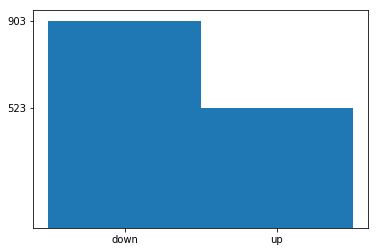

For:  Lag2


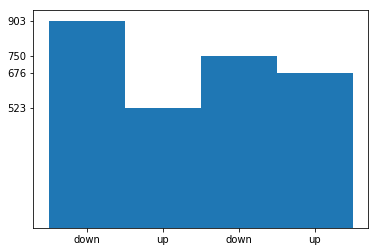

For:  Lag3


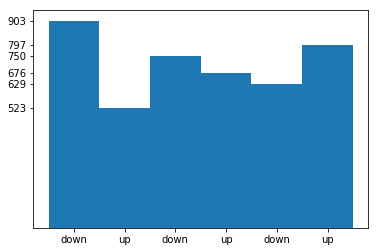

For:  Lag4


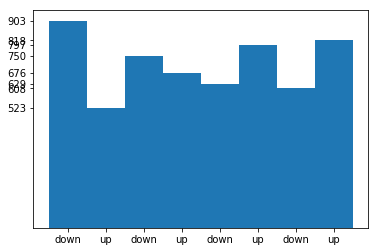

In [108]:
getStats(dfz)

In [109]:
#taking out target columns
LagDF = dfz[dfz.columns[-4:]]
LagDF.to_csv('tw_lag_MSFT.csv',index=False, index_label=None)

In [110]:
#taking out fetures columns
FeatureDF = dfz[dfz.columns[:-4]]
FeatureDF.to_csv('tw_feature_MSFT.csv',index=False, index_label=None)

In [111]:
#taking out fetures columns
FeatureDF.drop(columns=['tweet_sent'],inplace=True)
FeatureDF.to_csv('tw_feature_woText_MSFT.csv',index=False, index_label=None)

C:\Users\praveen ji\Anaconda3\lib\site-packages\pandas\core\frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


## Loading Data for Model Building

In [112]:
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_validate
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

In [113]:
import pandas as pd
import numpy as np
from dateutil.parser import parse
import datetime
import missingno as mn
import pylab as plt
from sklearn import model_selection
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.feature_selection import VarianceThreshold
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [114]:
featureDF_ = pd.read_csv('tw_feature_woText_MSFT.csv')
targetDF_ = pd.read_csv('tw_lag_MSFT.csv')


In [115]:
featureDF_.drop(columns=['date'],inplace=True)

In [116]:
featureDF_.head()

,lm_positive,retweet_count,tweet_len,lm_negative,lm_polarity,lm_subjectivity,actvie,passive,weak,strong,...,disgust,anticipation,fear,trust,tb_polarity,tb_subjectivity,hiv4_positive,hiv4_negative,hiv4_polarity,hiv4_subjectivity
0,1.0,2,703,1.0,0.000000,0.165000,1,4,2,5,...,0,0.002845,0.0,0.000000,2.400000,2.383333,5.0,2.0,2.333331,0.589387
1,0.0,4,266,1.0,-0.999999,0.047619,1,0,0,2,...,0,0.003759,0.0,0.000000,0.000000,0.300000,3.0,2.0,0.666666,0.326007
2,3.0,5,1914,0.0,2.999997,0.291667,7,1,7,5,...,0,0.000522,0.0,0.000000,1.250947,7.171212,19.0,5.0,7.999995,3.123412
3,1.0,3,1744,4.0,-2.999997,0.432984,1,1,5,3,...,0,0.000573,0.0,0.000573,0.322159,3.534091,2.0,7.0,-3.999997,1.258474
4,1.0,4,1825,1.0,0.000000,0.188034,1,2,4,3,...,0,0.000548,0.0,0.000000,0.325000,0.962500,11.0,6.0,2.333332,1.455759


In [117]:
def plotImportanceOfFeature(features,clf):
    importances = clf.feature_importances_
    indices = np.argsort(importances)

    plt.title('Feature Importances')
    plt.barh(range(len(indices)), importances[indices], color='b', align='center')
    plt.yticks(range(len(indices)), [features[i] for i in indices])
    plt.xlabel('Relative Importance')
    plt.show()

In [118]:
def corelationPlot (df_):
    corr = df_.corr()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
    fig.colorbar(cax)
    ticks = np.arange(0,len(df_.columns),1)
    ax.set_xticks(ticks)
    plt.xticks(rotation=90)
    ax.set_yticks(ticks)
    ax.set_xticklabels(df_.columns)
    ax.set_yticklabels(df_.columns)
    plt.show()

C:\Users\praveen ji\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:56: FutureWarning: 'argmax' is deprecated, use 'idxmax' instead. The behavior of 'argmax'
will be corrected to return the positional maximum in the future.
Use 'series.values.argmax' to get the position of the maximum now.
  return getattr(obj, method)(*args, **kwds)


['hiv4_subjectivity']


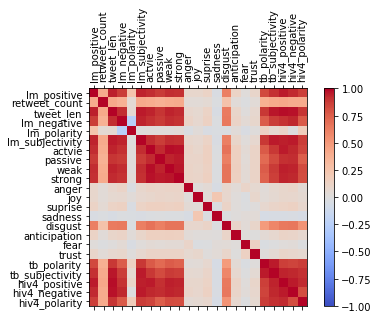

['hiv4_positive']


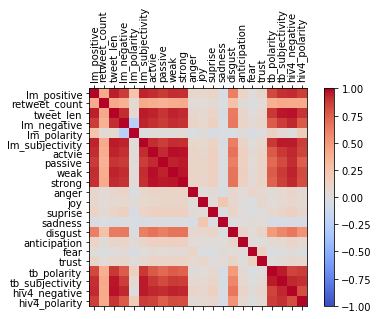

['tb_subjectivity']


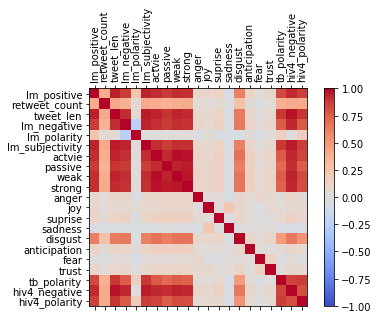

['lm_positive']


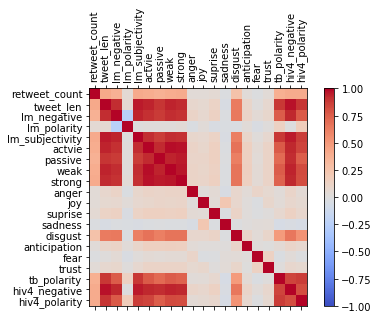

['tweet_len']


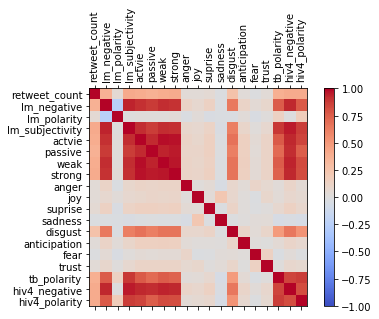

['lm_subjectivity']


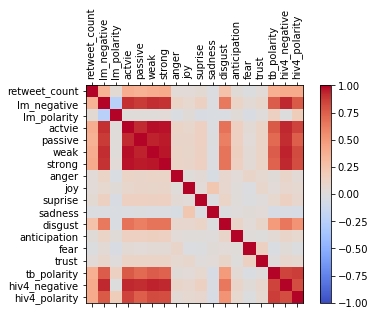

['actvie']


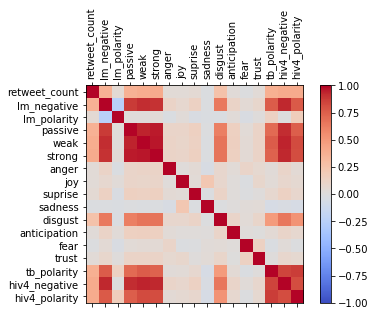

['hiv4_negative']


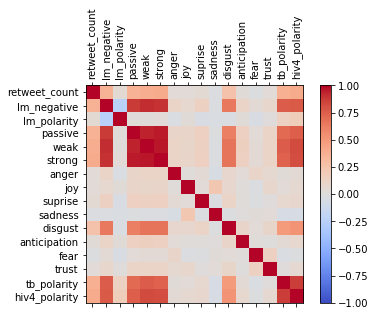

['strong']


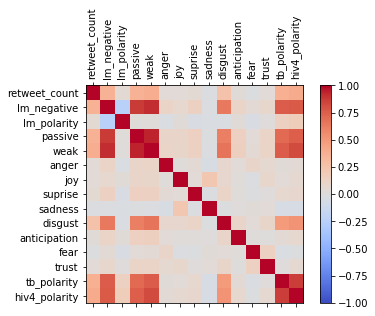

['weak']


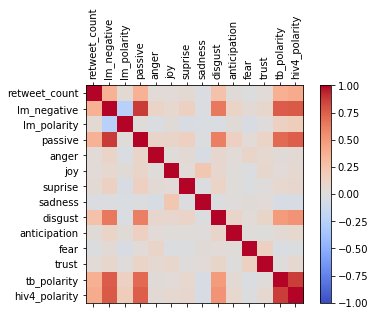

['lm_negative']


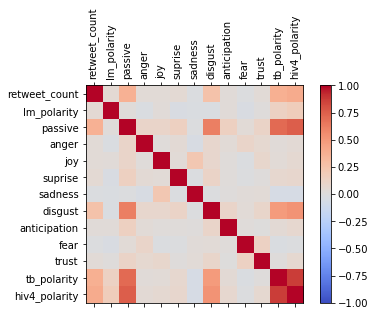

['hiv4_polarity']


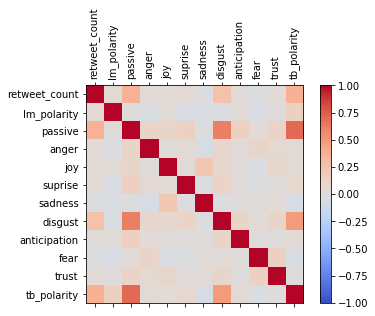

['passive']


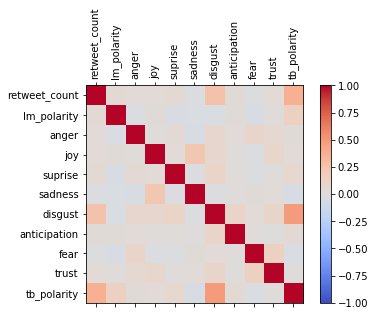

In [119]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(featureDF_.values, i) for i in range(featureDF_.values.shape[1])]
vif.round(1)
while max(vif["VIF Factor"])>10:
    vif = pd.DataFrame()
    vif["VIF Factor"] = [variance_inflation_factor(featureDF_.values, i) for i in range(featureDF_.values.shape[1])]
    vif.round(1)
    dropCol = [featureDF_.columns[np.argmax(vif["VIF Factor"])]]
    print(dropCol)
    featureDF_.drop(columns=dropCol, inplace=True)
    corelationPlot (featureDF_)

In [120]:
def computerConfusionMatrixAndAccuracy(featureDF , targetDF, features):
    for index in list(targetDF):
        train_features, test_features, train_labels, test_labels= model_selection.train_test_split( featureDF , targetDF[index], test_size=0.1, random_state=0)

        rf_model =RandomForestClassifier(n_estimators=5000, max_depth=4,random_state=0)
        rf_model.fit(train_features, train_labels)
        y_predicted=rf_model.predict(test_features)
        print('++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++' )
        print('For Lag:', index)
        
        plotImportanceOfFeature(features, rf_model)
        print('confusion_matrix',confusion_matrix(y_true=test_labels, y_pred=y_predicted))
        print('number of datapoints in Up Class', test_labels.value_counts()[1])
        print('number of datapoints in Down Class', test_labels.value_counts()[0])
        print('accuracy_score',accuracy_score(y_predicted, test_labels))
        print('classification_score\n',classification_report(y_predicted, test_labels))
        print('++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag1


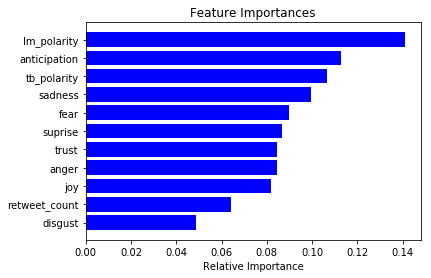

confusion_matrix [[97  0]
 [46  0]]
number of datapoints in Up Class 46
number of datapoints in Down Class 97
accuracy_score 0.6783216783216783
classification_score
               precision    recall  f1-score   support

           0       1.00      0.68      0.81       143
           1       0.00      0.00      0.00         0

   micro avg       0.68      0.68      0.68       143
   macro avg       0.50      0.34      0.40       143
weighted avg       1.00      0.68      0.81       143

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag2


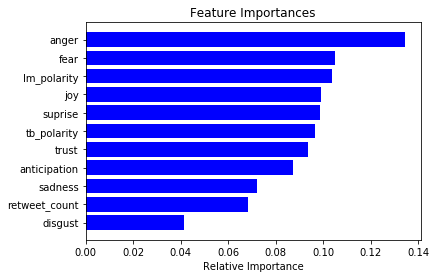

confusion_matrix [[65 16]
 [51 11]]
number of datapoints in Up Class 62
number of datapoints in Down Class 81
accuracy_score 0.5314685314685315
classification_score
               precision    recall  f1-score   support

           0       0.80      0.56      0.66       116
           1       0.18      0.41      0.25        27

   micro avg       0.53      0.53      0.53       143
   macro avg       0.49      0.48      0.45       143
weighted avg       0.68      0.53      0.58       143

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag3


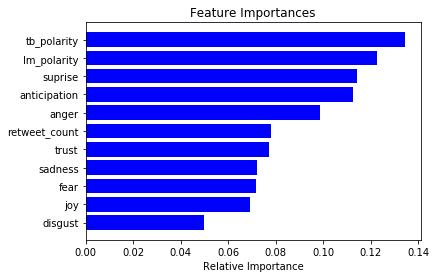

confusion_matrix [[ 1 70]
 [ 2 70]]
number of datapoints in Up Class 72
number of datapoints in Down Class 71
accuracy_score 0.4965034965034965
classification_score
               precision    recall  f1-score   support

           0       0.01      0.33      0.03         3
           1       0.97      0.50      0.66       140

   micro avg       0.50      0.50      0.50       143
   macro avg       0.49      0.42      0.34       143
weighted avg       0.95      0.50      0.65       143

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag4


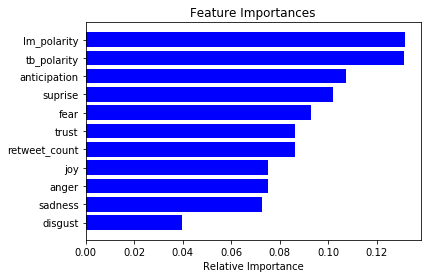

confusion_matrix [[ 4 59]
 [ 4 76]]
number of datapoints in Up Class 80
number of datapoints in Down Class 63
accuracy_score 0.5594405594405595
classification_score
               precision    recall  f1-score   support

           0       0.06      0.50      0.11         8
           1       0.95      0.56      0.71       135

   micro avg       0.56      0.56      0.56       143
   macro avg       0.51      0.53      0.41       143
weighted avg       0.90      0.56      0.67       143

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


In [121]:
features = list(featureDF_)
computerConfusionMatrixAndAccuracy(featureDF_ , targetDF_, features)

## Viz

In [122]:
upList = targetDF_['Lag1']
FwithT = featureDF_.copy()
FwithT['Target'] = upList

In [123]:
from mpl_toolkits.mplot3d import Axes3D

In [124]:
FwithT.head(2)

,retweet_count,lm_polarity,anger,joy,suprise,sadness,disgust,anticipation,fear,trust,tb_polarity,Target
0,2,0.000000,0.001422,0.001422,0.0,0.000000,0,0.002845,0.0,0.0,2.4,1
1,4,-0.999999,0.000000,0.000000,0.0,0.003759,0,0.003759,0.0,0.0,0.0,0


Text(0.5,0,'Target')

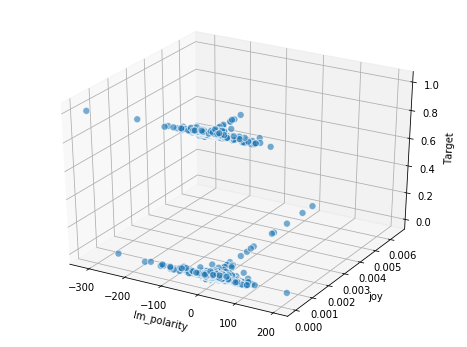

In [125]:
# Visualizing 3-D numeric data with Scatter Plots
# length, breadth and depth
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

xs = FwithT['lm_polarity']
ys = FwithT['joy']
zs = FwithT['Target']
ax.scatter(xs, ys, zs, s=50, alpha=0.6, edgecolors='w')

ax.set_xlabel('lm_polarity')
ax.set_ylabel('joy')
ax.set_zlabel('Target')

Text(0.5,0,'Joy')

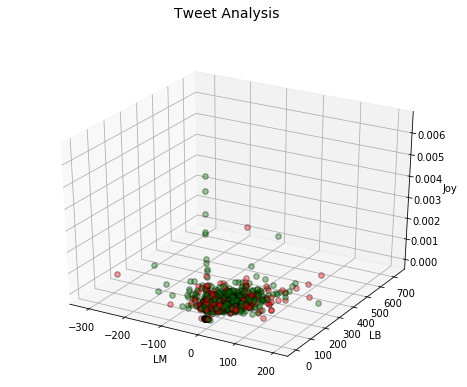

In [126]:
# Visualizing 4-D mix data using scatter plots
# leveraging the concepts of hue and depth
fig = plt.figure(figsize=(8, 6))
t = fig.suptitle('Tweet Analysis', fontsize=14)
ax = fig.add_subplot(111, projection='3d')

xs = list(FwithT['lm_polarity'])
ys = list(FwithT['tb_polarity'])
zs = list(FwithT['joy'])
data_points = [(x, y, z) for x, y, z in zip(xs, ys, zs)]
colors = ['green' if wt == 0 else 'red' for wt in list(FwithT['Target'])]

for data, color in zip(data_points, colors):
    x, y, z = data
    ax.scatter(x, y, z, alpha=0.4, c=color, edgecolors='none', s=30)

ax.set_xlabel('LM')
ax.set_ylabel('LB')
ax.set_zlabel('Joy')

Text(0.5,0,'disgust')

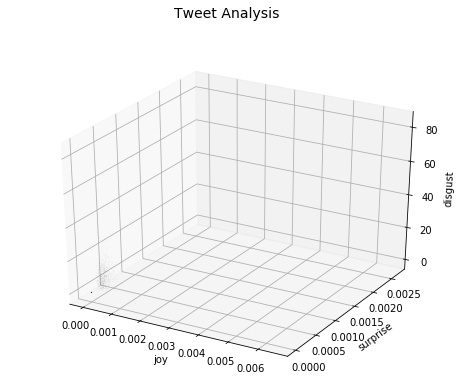

In [127]:

# Visualizing 6-D mix data using scatter charts
# leveraging the concepts of hue, size, depth and shape
fig = plt.figure(figsize=(8, 6))
t = fig.suptitle('Tweet Analysis', fontsize=14)
ax = fig.add_subplot(111, projection='3d')

xs = list(FwithT['joy'])
ys = list(FwithT['suprise'])
zs = list(FwithT['disgust'])
data_points = [(x, y, z) for x, y, z in zip(xs, ys, zs)]
colors = ['red' if wt == 0 else 'yellow' for wt in list(FwithT['Target'])]

ss = list(FwithT['fear'])
colors = ['red' if wt == 0 else 'yellow' for wt in list(FwithT['Target'])]
markers = [',' if q == 'high' else 'x' if q == 'medium' else 'o' for q in list(FwithT['lm_polarity'])]

for data, color, size, mark in zip(data_points, colors, ss, markers):
    x, y, z = data
    ax.scatter(x, y, z, alpha=0.4, c=color, edgecolors='none', s=size, marker=mark)

ax.set_xlabel('joy')
ax.set_ylabel('surprise')
ax.set_zlabel('disgust')

## Bert for DataProcessing

In [7]:
import numpy as np 
import pandas as pd
import re
import gc
import os
import fileinput
import string
# import tensorflow as tf
import zipfile
import datetime
import sys
from tqdm  import tqdm
tqdm.pandas()
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

In [8]:
bertDf = pd.read_csv('tw_feature_MSFT.csv')
targetDF_ = pd.read_csv('tw_lag_MSFT.csv')


In [9]:
def clean_text(text):
    
    ## Remove puncuation
    text = text.translate(string.punctuation)
    
    ## Convert words to lower case and split them
    text = text.lower().split()
    
    ## Remove stop words
    
    text = " ".join(text)
    ## Clean the text
    text = re.sub(r"[^A-Za-z0-9^,!.\/'+-=]", " ", text)
    text = re.sub(r"what's", "what is ", text)
    text = re.sub(r"\'s", " ", text)
    text = re.sub(r"\'ve", " have ", text)
    text = re.sub(r"n't", " not ", text)
    text = re.sub(r"i'm", "i am ", text)
    text = re.sub(r"\'re", " are ", text)
    text = re.sub(r"\'d", " would ", text)
    text = re.sub(r"\'ll", " will ", text)
    text = re.sub(r",", " ", text)
    text = re.sub(r"\.", " ", text)
    text = re.sub(r"!", " ! ", text)
    text = re.sub(r"\/", " ", text)
    text = re.sub(r"\^", " ^ ", text)
    text = re.sub(r"\+", " + ", text)
    text = re.sub(r"\-", " - ", text)
    text = re.sub(r"\=", " = ", text)
    text = re.sub(r"'", " ", text)
    text = re.sub(r"(\d+)(k)", r"\g<1>000", text)
    text = re.sub(r":", " : ", text)
    text = re.sub(r" e g ", " eg ", text)
    text = re.sub(r" b g ", " bg ", text)
    text = re.sub(r" u s ", " american ", text)
    text = re.sub(r"\0s", "0", text)
    text = re.sub(r" 9 11 ", "911", text)
    text = re.sub(r"e - mail", "email", text)
    text = re.sub(r"j k", "jk", text)
    text = re.sub(r"\s{2,}", " ", text)
    ## Stemming
    text = text.split()
    stemmer = SnowballStemmer('english')
    stemmed_words = [stemmer.stem(word) for word in text]
    text = " ".join(stemmed_words)
    return text


In [10]:
def createComparableDataset(_df):
    _df.date = pd.to_datetime(_df.date)
    _df = _df[_df['date'] >= pd.to_datetime('2015/05/04')]
    _df = _df[_df['date'] <= pd.to_datetime('2019/03/28')]
    return _df

In [11]:
bertDf = createComparableDataset(bertDf)

In [12]:
bertDf.head(2)

,date,lm_positive,retweet_count,tweet_len,tweet_sent,lm_negative,lm_polarity,lm_subjectivity,actvie,passive,...,disgust,anticipation,fear,trust,tb_polarity,tb_subjectivity,hiv4_positive,hiv4_negative,hiv4_polarity,hiv4_subjectivity
0,2015-05-04,1.0,2,703,t really worry about revenue (MSFT) http ://fe...,1.0,0.000000,0.165000,1,4,...,0,0.002845,0.0,0.0,2.4,2.383333,5.0,2.0,2.333331,0.589387
1,2015-05-05,0.0,4,266,Will Microsoft Buy Salesforce ? CRM MSFT : The...,1.0,-0.999999,0.047619,1,0,...,0,0.003759,0.0,0.0,0.0,0.300000,3.0,2.0,0.666666,0.326007


In [13]:
bertProcessedText = bertDf['tweet_sent'].progress_apply(clean_text)

100%|██████████████████████████████████████████████████████████████████████████████| 1419/1419 [03:29<00:00,  4.90it/s]


In [14]:
len(bertProcessedText)

1419

In [15]:
#bert-serving-start -model_dir C:/bert/ -num_worker=4
from bert_serving.client import BertClient
bc = BertClient()

In [16]:
len(bertProcessedText[0])

692

In [17]:
for counter in range(len(bertProcessedText)):
    if len(bertProcessedText[counter]) ==0:
        bertProcessedText[counter] = "empty"

In [18]:
bertVectorList = list()
bertVectorList.extend(bc.encode(list(bertProcessedText),))

C:\Users\praveen ji\Anaconda3\envs\tf_gpu\lib\site-packages\bert_serving\client\__init__.py:286: UserWarning: some of your sentences have more tokens than "max_seq_len=25" set on the server, as consequence you may get less-accurate or truncated embeddings.
here is what you can do:
- disable the length-check by create a new "BertClient(check_length=False)" when you do not want to display this warning
- or, start a new server with a larger "max_seq_len"
  '- or, start a new server with a larger "max_seq_len"' % self.length_limit)


In [19]:
df = pd.DataFrame(bertVectorList)

In [20]:
df.to_csv('BertVector.csv', index= False)

## BERT Model

In [147]:
df = pd.read_csv('BertVector.csv')
targetDF_ =pd.read_csv('tw_lag_MSFT.csv')

In [148]:
def computerConfusionMatrixAndAccuracy(featureDF , targetDF):
    for index in list(targetDF):
        train_features, test_features, train_labels, test_labels= model_selection.train_test_split( featureDF , targetDF[index], test_size=0.1, random_state=0)

        rf_model =RandomForestClassifier(n_estimators=5000, max_depth=4,random_state=0)
        rf_model.fit(train_features, train_labels)
        y_predicted=rf_model.predict(test_features)
        print('++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++' )
        print('For Lag:', index)
        
        print('confusion_matrix',confusion_matrix(y_true=test_labels, y_pred=y_predicted))
        print('number of datapoints in Up Class', test_labels.value_counts()[1])
        print('number of datapoints in Down Class', test_labels.value_counts()[0])
        print('accuracy_score',accuracy_score(y_predicted, test_labels))
        print('classification_score\n',classification_report(y_predicted, test_labels))
        print('++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')

In [149]:
computerConfusionMatrixAndAccuracy(df , targetDF_)

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag1
confusion_matrix [[95  2]
 [46  0]]
number of datapoints in Up Class 46
number of datapoints in Down Class 97
accuracy_score 0.6643356643356644
classification_score
               precision    recall  f1-score   support

           0       0.98      0.67      0.80       141
           1       0.00      0.00      0.00         2

   micro avg       0.66      0.66      0.66       143
   macro avg       0.49      0.34      0.40       143
weighted avg       0.97      0.66      0.79       143

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
For Lag: Lag2
confusion_matrix [[71 10]
 [53  9]]
number of datapoints in Up Class 62
number of datapoints in Down Class 81
accuracy_score 0.5594405594405595
classification_score
               precisio

## Naive Bayes Classifier - Trust Feature

In [13]:
import numpy as nd
import pandas as pd

In [14]:
featureDF_ = pd.read_csv('tw_feature_MSFT.csv')
targetDF_ = pd.read_csv('tw_lag_MSFT.csv')
TextForProcessing = list(featureDF_['tweet_sent'])
targetArr = nd.array(targetDF_['Lag1'])

In [152]:
print(len(TextForProcessing))
print(len(targetArr))

1426
1426


In [153]:
import sklearn

In [154]:
train_features, test_features, train_labels, test_labels= model_selection.train_test_split( TextForProcessing , targetArr, test_size=0.1, random_state=0)

In [155]:
from sklearn.feature_extraction.text import CountVectorizer
count_vect = CountVectorizer()
X_train_counts = count_vect.fit_transform(train_features)
X_train_counts.shape

(1283, 744662)

In [156]:
# TF-IDF
from sklearn.feature_extraction.text import TfidfTransformer
tfidf_transformer = TfidfTransformer()
X_train_tfidf = tfidf_transformer.fit_transform(X_train_counts)
X_train_tfidf.shape

(1283, 744662)

In [157]:
from sklearn.naive_bayes import MultinomialNB
clf = MultinomialNB().fit(X_train_tfidf,train_labels)

In [158]:
from sklearn.pipeline import Pipeline

text_clf = Pipeline([('vect', CountVectorizer()), ('tfidf', TfidfTransformer()), ('clf', MultinomialNB())])

text_clf = text_clf.fit(train_features, train_labels)

In [159]:
import numpy as np
predicted = text_clf.predict(test_features)
np.mean(predicted == test_labels)

print('Confusion Matrix\n',confusion_matrix(predicted, test_labels))
print('classification_score\n',classification_report(predicted, test_labels))

Confusion Matrix
 [[97 46]
 [ 0  0]]


C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


classification_score
               precision    recall  f1-score   support

           0       1.00      0.68      0.81       143
           1       0.00      0.00      0.00         0

   micro avg       0.68      0.68      0.68       143
   macro avg       0.50      0.34      0.40       143
weighted avg       1.00      0.68      0.81       143



In [160]:
from sklearn.linear_model import SGDClassifier
text_clf_svm = Pipeline([('vect', CountVectorizer()), ('tfidf', TfidfTransformer()),
                         ('clf-svm', SGDClassifier(loss='hinge', penalty='l2',alpha=1e-3, n_iter=5, random_state=42))])

text_clf_svm = text_clf_svm.fit(train_features,train_labels)
predicted_svm = text_clf_svm.predict(test_features)
np.mean(predicted_svm == test_labels)
print('confusion_matrix\n',confusion_matrix(predicted, test_labels))
print('classification_score\n',classification_report(predicted, test_labels))

C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\linear_model\stochastic_gradient.py:152: DeprecationWarning: n_iter parameter is deprecated in 0.19 and will be removed in 0.21. Use max_iter and tol instead.
  DeprecationWarning)


confusion_matrix
 [[97 46]
 [ 0  0]]


C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


classification_score
               precision    recall  f1-score   support

           0       1.00      0.68      0.81       143
           1       0.00      0.00      0.00         0

   micro avg       0.68      0.68      0.68       143
   macro avg       0.50      0.34      0.40       143
weighted avg       1.00      0.68      0.81       143



In [161]:
from sklearn.model_selection import GridSearchCV
parameters = {'vect__ngram_range': [(1, 1), (1, 2)], 'tfidf__use_idf': (True, False), 'clf__alpha': (1e-2, 1e-3)}

In [162]:
gs_clf = GridSearchCV(text_clf, parameters, n_jobs=-1)
gs_clf = gs_clf.fit(train_features, train_labels)

C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


In [163]:
gs_clf.best_score_
gs_clf.best_params_

{'clf__alpha': 0.01, 'tfidf__use_idf': False, 'vect__ngram_range': (1, 1)}

In [164]:
from sklearn.model_selection import GridSearchCV
parameters_svm = {'vect__ngram_range': [(1, 1), (1, 2)], 'tfidf__use_idf': (True, False),'clf-svm__alpha': (1e-2, 1e-3)}

gs_clf_svm = GridSearchCV(text_clf_svm, parameters_svm, n_jobs=-1)
gs_clf_svm = gs_clf_svm.fit(train_features, train_labels)


gs_clf_svm.best_score_
gs_clf_svm.best_params_

C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\linear_model\stochastic_gradient.py:152: DeprecationWarning: n_iter parameter is deprecated in 0.19 and will be removed in 0.21. Use max_iter and tol instead.
  DeprecationWarning)


{'clf-svm__alpha': 0.01, 'tfidf__use_idf': True, 'vect__ngram_range': (1, 1)}

In [165]:
from sklearn.pipeline import Pipeline
text_clf = Pipeline([('vect', CountVectorizer(stop_words='english')), ('tfidf', TfidfTransformer()), 
                     ('clf', MultinomialNB())])

In [166]:
import nltk
# nltk.download()

from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer("english", ignore_stopwords=True)

class StemmedCountVectorizer(CountVectorizer):
    def build_analyzer(self):
        analyzer = super(StemmedCountVectorizer, self).build_analyzer()
        return lambda doc: ([stemmer.stem(w) for w in analyzer(doc)])
    
stemmed_count_vect = StemmedCountVectorizer(stop_words='english')

text_mnb_stemmed = Pipeline([('vect', stemmed_count_vect), ('tfidf', TfidfTransformer()), 
                             ('mnb', MultinomialNB(fit_prior=False))])

text_mnb_stemmed = text_mnb_stemmed.fit(train_features, train_labels)

predicted_mnb_stemmed = text_mnb_stemmed.predict(test_features)


print('accuracy: ', np.mean(predicted_mnb_stemmed == test_labels))
print('classification_score\n',classification_report(predicted_mnb_stemmed, test_labels))

accuracy:  0.6783216783216783


C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\praveen ji\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


classification_score
               precision    recall  f1-score   support

           0       1.00      0.68      0.81       143
           1       0.00      0.00      0.00         0

   micro avg       0.68      0.68      0.68       143
   macro avg       0.50      0.34      0.40       143
weighted avg       1.00      0.68      0.81       143



## WordCloud

In [11]:
from wordcloud import WordCloud, STOPWORDS
from PIL import Image
import urllib
import requests
import numpy as np
import matplotlib.pyplot as plt

In [15]:
upList = targetDF_['Lag1']
FwithT = featureDF_.copy()
FwithT['Target'] = upList

In [16]:
# upList = targetDF_['Lag1']
# df["Target"] =upList

In [10]:
#wordcloud.to_file("img/first_review.png")

In [17]:
STOPWORDS.add(('MSFT','Microsoft','Twitter','AAPL','GOOG'))

In [18]:
import nltk
import numpy as np 
import pandas as pd
import re
import gc
import os
import fileinput
import string
# import tensorflow as tf
import zipfile
import datetime
import sys
from tqdm  import tqdm
tqdm.pandas()
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

In [19]:
import nltk
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer("english", ignore_stopwords=True)
from nltk import pos_tag 

In [46]:
df.head(2)

,tweet,date_time,retweet_count,fav_count,HNA_combine,Target
0,Adobe and Microsoft Team Up to Challenge Sales...,2019-04-04 00:57,0,0,),1.0
1,"That’s right, he’s our jerk.",2019-04-04 00:52,0,2,),0.0


In [20]:
from nltk import sent_tokenize
sentences = sent_tokenize("-".join((df.loc[df['Target'] == 1]).tweet.tolist()[:100]))
sentences
# "-".join((df.loc[df['Target'] == 1]).tweet.tolist()[:10])

['Adobe and Microsoft Team Up to Challenge Salesforce @ themotleyfool # stocks $ MSFT $ ADBE $ CRMhttps://www.fool.com/investing/2019/04/03/adobe-microsoft-team-up-to-challenge-salesforce.aspx …-Buy Microsoft (MSFT), Not FAANG Stocks for Stable Growth & Income - April 3, 2019 - http://Zacks.com https://www.zacks.com/stock/news/370414/buy-microsoft-msft-not-faang-stocks-for-stable-growth-amp-income?cid=SM-twitter-HL-370414 …-https://twitter.com/papeeechulo/status/1113579869655457793 …-You only need one physical node to autoscale infinitely, Azure Kubernetes Service with a virtual node will take care of the rest.',
 'Follow the link to watch the full demo.',
 "https://youtu.be/NVX1p502qCU pic.twitter.com/OSTnFb3ukr-Sorry, that may have been a form of Ultron I've been working on.",
 "I'll fix it, gimme a sec....-Un bal d’hypocrite-Año Fundacion 1800 65 Nokia 76 Ericsson 89 Nintendo 1900 11 IBM 28 Motorola 38 Samsung 39 HP 46 Sony 68 Intel 72 SAP 75 Msft 76 Apple 77 Oracle 84 Dell 84 Cisco

In [59]:


words = "-".join(sentences)
mask = np.array(Image.open('thumbs_up.png'))

# This function takes in your text and your mask and generates a wordcloud. 
def generate_wordcloud(words, mask):
    word_cloud = WordCloud(width = 512, height = 512, background_color='white', collocations = False, stopwords=STOPWORDS, mask=mask).generate(str(words))
    plt.figure(figsize=(10,8),facecolor = 'white', edgecolor='blue')
    plt.imshow(word_cloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()
    
#Run the following to generate your wordcloud
pos = nltk.pos_tag(words)
words = [stemmer.stem(tagged_word[0]) for tagged_word in pos]
generate_wordcloud(words, mask)

AttributeError: 'tuple' object has no attribute 'lower'

In [194]:

words = "-".join(FwithT.loc[FwithT['Target'] == 0]['tweet_sent'].tolist())[:100]
mask = np.array(Image.open('thumbs_up_down.PNG'))

# This function takes in your text and your mask and generates a wordcloud. 
def generate_wordcloud(words, mask):
    word_cloud = WordCloud(width = 512, height = 512, background_color='white', collocations = False, stopwords=STOPWORDS, mask=mask).generate(words)
    plt.figure(figsize=(10,8),facecolor = 'white', edgecolor='blue')
    plt.imshow(word_cloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    
    plt.show()
    
#Run the following to generate your wordcloud
pos = nltk.pos_tag(words)
words = [stemmer.stem(tagged_word[0]) for tagged_word in pos]
generate_wordcloud(words[:10000], mask)

AttributeError: 'tuple' object has no attribute 'lower'